# **Sentiment Based Product Recommendation System** 

---



## **Import Packages**

The e-commerce business is quite popular today. Here, you do not need to take orders by going to each customer. A company launches its website to sell the items to the end consumer, and customers can order the products that they require from the same website. Famous examples of such e-commerce companies are Amazon, Flipkart, Myntra, Paytm and Snapdeal.

 

Suppose you are working as a Machine Learning Engineer in an e-commerce company named 'Ebuss'. Ebuss has captured a huge market share in many fields, and it sells the products in various categories such as household essentials, books, personal care products, medicines, cosmetic items, beauty products, electrical appliances, kitchen and dining products and health care products.

 

With the advancement in technology, it is imperative for Ebuss to grow quickly in the e-commerce market to become a major leader in the market because it has to compete with the likes of Amazon, Flipkart, etc., which are already market leaders.

 

As a senior ML Engineer, you are asked to build a model that will improve the recommendations given to the users given their past reviews and ratings. 

 

In order to do this, you planned to build a sentiment-based product recommendation system, which includes the following tasks.

Data sourcing and sentiment analysis
Building a recommendation system
Improving the recommendations using the sentiment analysis model
Deploying the end-to-end project with a user interface
 

Data sourcing and sentiment analysis
In this task, you have to analyse product reviews after some text preprocessing steps and build an ML model to get the sentiments corresponding to the users' reviews and ratings for multiple products.

In [ ]:
# Import the following basic libraries
import pandas as pd
import numpy as np
from collections import defaultdict
from collections import Counter
import csv
import re 
import string

# To change date to datetime
from datetime import datetime
import time


# Visualization libraries
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt


# To show all the columns
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_colwidth', 300)

# Avoid warnings
import warnings
warnings.filterwarnings("ignore")

# Enable logging for gensim - optional but important
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

from IPython.display import clear_output
clear_output()

In [ ]:
# NLTK libraries
import nltk
nltk.download('all')
from nltk.corpus import stopwords
from nltk import FreqDist
from nltk.tokenize import word_tokenize
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.corpus import wordnet

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /root/nltk_data...
[nltk_data]    |   Package abc is already up-to-date!
[nltk_data]    | Downloading package alpino to /root/nltk_data...
[nltk_data]    |   Package alpino is already up-to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger is already up-
[nltk_data]    |       to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger_ru is already
[nltk_data]    |       up-to-date!
[nltk_data]    | Downloading package basque_grammars to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package basque_grammars is already up-to-date!
[nltk_data]    | Downloading package biocreative_ppi to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Pac

In [ ]:
# Modelling
from sklearn.model_selection import cross_val_score
from scipy.sparse import hstack
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import KFold, cross_val_score
from sklearn.metrics.pairwise import cosine_similarity

## **Load the Dataset**

In [472]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/NLP Capstone Project/sample30.csv')

In [ ]:
df.head(2)

,id,brand,categories,manufacturer,name,reviews_date,reviews_didPurchase,reviews_doRecommend,reviews_rating,reviews_text,reviews_title,reviews_userCity,reviews_userProvince,reviews_username,user_sentiment
0,AV13O1A8GV-KLJ3akUyj,Universal Music,"Movies, Music & Books,Music,R&b,Movies & TV,Movie Bundles & Collections,CDs & Vinyl,Rap & Hip-Hop,Bass,Music on CD or Vinyl,Rap,Hip-Hop,Mainstream Rap,Pop Rap",Universal Music Group / Cash Money,Pink Friday: Roman Reloaded Re-Up (w/dvd),2012-11-30T06:21:45.000Z,NaN,NaN,5,i love this album. it's very good. more to the hip hop side than her current pop sound.. SO HYPE! i listen to this everyday at the gym! i give it 5star rating all the way. her metaphors are just crazy.,Just Awesome,Los Angeles,NaN,joshua,Positive
1,AV14LG0R-jtxr-f38QfS,Lundberg,"Food,Packaged Foods,Snacks,Crackers,Snacks, Cookies & Chips,Rice Cakes,Cakes",Lundberg,Lundberg Organic Cinnamon Toast Rice Cakes,2017-07-09T00:00:00.000Z,True,NaN,5,Good flavor. This review was collected as part of a promotion.,Good,NaN,NaN,dorothy w,Positive


## **Data Cleaning**

In [ ]:
# Print the shape of the dataset.
print("Shape :", df.shape)

Shape : (30000, 15)


In [ ]:
# Print the columns of the dataset.
print("Columns :")
print(df.columns)

Columns :
Index(['id', 'brand', 'categories', 'manufacturer', 'name', 'reviews_date',
       'reviews_didPurchase', 'reviews_doRecommend', 'reviews_rating',
       'reviews_text', 'reviews_title', 'reviews_userCity',
       'reviews_userProvince', 'reviews_username', 'user_sentiment'],
      dtype='object')


In [ ]:
# Print the information about the dataset columns.
print("Info :")
print(df.info())

Info :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 15 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   id                    30000 non-null  object
 1   brand                 30000 non-null  object
 2   categories            30000 non-null  object
 3   manufacturer          29859 non-null  object
 4   name                  30000 non-null  object
 5   reviews_date          29954 non-null  object
 6   reviews_didPurchase   15932 non-null  object
 7   reviews_doRecommend   27430 non-null  object
 8   reviews_rating        30000 non-null  int64 
 9   reviews_text          30000 non-null  object
 10  reviews_title         29810 non-null  object
 11  reviews_userCity      1929 non-null   object
 12  reviews_userProvince  170 non-null    object
 13  reviews_username      29937 non-null  object
 14  user_sentiment        29999 non-null  object
dtypes: int64(1), object(14)
memor

In [ ]:
# Finding the count of missing values in each columns.
print("Missing Value Count :")
print(df.isnull().sum())

Missing Value Count :
id                          0
brand                       0
categories                  0
manufacturer              141
name                        0
reviews_date               46
reviews_didPurchase     14068
reviews_doRecommend      2570
reviews_rating              0
reviews_text                0
reviews_title             190
reviews_userCity        28071
reviews_userProvince    29830
reviews_username           63
user_sentiment              1
dtype: int64


In [ ]:
#Finding the percentage of missing values in each columns.
print("Percentage of missing values :")
print(df.isna().mean().round(4) * 100)

Percentage of missing values :
id                       0.00
brand                    0.00
categories               0.00
manufacturer             0.47
name                     0.00
reviews_date             0.15
reviews_didPurchase     46.89
reviews_doRecommend      8.57
reviews_rating           0.00
reviews_text             0.00
reviews_title            0.63
reviews_userCity        93.57
reviews_userProvince    99.43
reviews_username         0.21
user_sentiment           0.00
dtype: float64


In [ ]:
# Drop the columns with more than 50% of missing values.
missing_val_threshold = len(df) * .5
df.dropna(thresh = missing_val_threshold, axis = 1, inplace = True)

In [ ]:
# Drop the 'reviews_doRecommend'& 'reviews_didPurchase' column also as this is of no use for our analysis.
df= df.drop(columns=['reviews_doRecommend'])
df= df.drop(columns=['reviews_didPurchase'])

In [ ]:
#Finding the percentage of missing values in remaining columns.
print("Percentage of missing values :")
print(df.isna().mean().round(4) * 100)

Percentage of missing values :
id                  0.00
brand               0.00
categories          0.00
manufacturer        0.47
name                0.00
reviews_date        0.15
reviews_rating      0.00
reviews_text        0.00
reviews_title       0.63
reviews_username    0.21
user_sentiment      0.00
dtype: float64


In [ ]:
# Drop the NULL value rows of reviews_text, reviews_title, reviews_username, user_sentiment, reviews_date, manufacture. 
df = df[df['reviews_text'].notna()]
df = df[df['reviews_title'].notna()]
df = df[df['reviews_username'].notna()]
df = df[df['user_sentiment'].notna()]
df = df[df['reviews_date'].notna()]
df = df[df['manufacturer'].notna()]

In [ ]:
#Finding the percentage of missing values in remaining columns.
print("Percentage of missing values :")
print(df.isna().mean().round(4) * 100)

Percentage of missing values :
id                  0.0
brand               0.0
categories          0.0
manufacturer        0.0
name                0.0
reviews_date        0.0
reviews_rating      0.0
reviews_text        0.0
reviews_title       0.0
reviews_username    0.0
user_sentiment      0.0
dtype: float64


In [ ]:
df.columns

Index(['id', 'brand', 'categories', 'manufacturer', 'name', 'reviews_date',
       'reviews_rating', 'reviews_text', 'reviews_title', 'reviews_username',
       'user_sentiment'],
      dtype='object')

In [ ]:
# Renaming the columns
df.rename(columns={'reviews_username' : 'userID','name':'prod_name'}, inplace=True)

In [ ]:
df.columns

Index(['id', 'brand', 'categories', 'manufacturer', 'prod_name',
       'reviews_date', 'reviews_rating', 'reviews_text', 'reviews_title',
       'userID', 'user_sentiment'],
      dtype='object')

In [ ]:
# Shape of Dataset: Total of 14 columns are there now.
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29566 entries, 0 to 29999
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   id              29566 non-null  object
 1   brand           29566 non-null  object
 2   categories      29566 non-null  object
 3   manufacturer    29566 non-null  object
 4   prod_name       29566 non-null  object
 5   reviews_date    29566 non-null  object
 6   reviews_rating  29566 non-null  int64 
 7   reviews_text    29566 non-null  object
 8   reviews_title   29566 non-null  object
 9   userID          29566 non-null  object
 10  user_sentiment  29566 non-null  object
dtypes: int64(1), object(10)
memory usage: 2.7+ MB


Converting the Target Variable (user_sentiment) into Binary Numerical Value for Modelling Purposes

In [ ]:
# Convert the user sentiment column into binary values: Positive to 1 and Negative to 0.

def get_sentiment_binary(x):
    if(x== 'Positive'):
        return 1
    else:
        return 0

#Convert user_sentiment string into binary.
df['user_sentiment']=df['user_sentiment'].apply(get_sentiment_binary)

In [ ]:
# Shape of Dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29566 entries, 0 to 29999
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   id              29566 non-null  object
 1   brand           29566 non-null  object
 2   categories      29566 non-null  object
 3   manufacturer    29566 non-null  object
 4   prod_name       29566 non-null  object
 5   reviews_date    29566 non-null  object
 6   reviews_rating  29566 non-null  int64 
 7   reviews_text    29566 non-null  object
 8   reviews_title   29566 non-null  object
 9   userID          29566 non-null  object
 10  user_sentiment  29566 non-null  int64 
dtypes: int64(2), object(9)
memory usage: 2.7+ MB


## **Text Processing**

### **Combine Review Text and Title into one**

In [ ]:
df[['reviews_title','reviews_text']].head(n=2)

,reviews_title,reviews_text
0,Just Awesome,i love this album. it's very good. more to the hip hop side than her current pop sound.. SO HYPE! i listen to this everyday at the gym! i give it 5star rating all the way. her metaphors are just crazy.
1,Good,Good flavor. This review was collected as part of a promotion.


In [ ]:
# Joining Review Text and Title.
df['Review'] = df['reviews_title'] + " " + df['reviews_text'] 

In [ ]:
df['Review'].head()

0                                                                                         Just Awesome i love this album. it's very good. more to the hip hop side than her current pop sound.. SO HYPE! i listen to this everyday at the gym! i give it 5star rating all the way. her metaphors are just crazy.
1                                                                                                                                                                                                                                            Good Good flavor. This review was collected as part of a promotion.
2                                                                                                                                                                                                                                                                                              Good Good flavor.
3    Disappointed I read through the reviews on here before looking in to buying one 

### **Lowercasing**

In [ ]:
# Lowercasing the reviews and title column
df['Review'] = df['Review'].apply(lambda x : x.lower())

In [ ]:
# Print the first review from row1
df['Review'].head()

0                                                                                         just awesome i love this album. it's very good. more to the hip hop side than her current pop sound.. so hype! i listen to this everyday at the gym! i give it 5star rating all the way. her metaphors are just crazy.
1                                                                                                                                                                                                                                            good good flavor. this review was collected as part of a promotion.
2                                                                                                                                                                                                                                                                                              good good flavor.
3    disappointed i read through the reviews on here before looking in to buying one 

### **Remove Punctuation**

In [ ]:
# Remove punctuation 
df['Review'] = df['Review'].str.replace('[^\w\s]','')

In [ ]:
# Print the first review from row1
df['Review'].head()

0                                                                                                  just awesome i love this album its very good more to the hip hop side than her current pop sound so hype i listen to this everyday at the gym i give it 5star rating all the way her metaphors are just crazy
1                                                                                                                                                                                                                                              good good flavor this review was collected as part of a promotion
2                                                                                                                                                                                                                                                                                               good good flavor
3    disappointed i read through the reviews on here before looking in to buying one 

### **Remove Stopwords**

In [ ]:
# Remove Stopwords
stop = stopwords.words('english')
df['Review'] = df['Review'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))

In [ ]:
# Print the first review from row1
df['Review'].head()

0                                                                                                                                                                                          awesome love album good hip hop side current pop sound hype listen everyday gym give 5star rating way metaphors crazy
1                                                                                                                                                                                                                                                               good good flavor review collected part promotion
2                                                                                                                                                                                                                                                                                               good good flavor
3    disappointed read reviews looking buying one couples lubricants ultimately disap

### **Lemmatization**

In [ ]:
lemmatizer = nltk.stem.WordNetLemmatizer()
wordnet_lemmatizer = WordNetLemmatizer() 

In [ ]:
def nltk_tag_to_wordnet_tag(nltk_tag):
    if nltk_tag.startswith('J'):
        return wordnet.ADJ
    elif nltk_tag.startswith('V'):
        return wordnet.VERB
    elif nltk_tag.startswith('N'):
        return wordnet.NOUN
    elif nltk_tag.startswith('R'):
        return wordnet.ADV
    else:
        return None

In [ ]:
def lemmatize_sentence(sentence):
    #tokenize the sentence and find the POS tag for each token
    nltk_tagged = nltk.pos_tag(nltk.word_tokenize(sentence))
    #tuple of (token, wordnet_tag)
    wordnet_tagged = map(lambda x: (x[0], nltk_tag_to_wordnet_tag(x[1])), nltk_tagged)
    lemmatized_sentence = []
    for word, tag in wordnet_tagged:
        if tag is None:
            #if there is no available tag, append the token as is
            lemmatized_sentence.append(word)
        else:
            #else use the tag to lemmatize the token
            lemmatized_sentence.append(lemmatizer.lemmatize(word, tag))
    return " ".join(lemmatized_sentence)

In [ ]:
# Apply Lemmetisation
df['Review']=df['Review'].apply(lambda x: lemmatize_sentence(x))

In [ ]:
# Print the first review from row1
df['Review'][0]

'awesome love album good hip hop side current pop sound hype listen everyday gym give 5star rating way metaphor crazy'

### **Noise Removal**

In [ ]:
def scrub_words(text):
    """Basic cleaning of texts."""
    
    # remove html markup
    text=re.sub("(<.*?>)","",text)
    
    #remove non-ascii and digits
    text=re.sub("(\\W|\\d)"," ",text)
    
    #remove whitespace
    text=text.strip()
    return text

In [ ]:
df['Review']=df['Review'].apply(lambda x: scrub_words(x))

In [ ]:
# Print the first review from row1
df['Review'][0]

'awesome love album good hip hop side current pop sound hype listen everyday gym give  star rating way metaphor crazy'

## **Defining Features & Target Variables, Train Test Split, Build the TF-IDF Vectorizer**

### **Defining features and target variables**

In [ ]:
x=df['Review'] 
y=df['user_sentiment']

In [ ]:
#Distribution of the target variable data.
print(pd.Series(y).value_counts())

1    26262
0     3304
Name: user_sentiment, dtype: int64


In [ ]:
# #Distribution of the target variable data in terms of proportions.
print("Percent of 1s: ", 100*pd.Series(y).value_counts()[1]/pd.Series(y).value_counts().sum(), "%")
print("Percent of 0s: ", 100*pd.Series(y).value_counts()[0]/pd.Series(y).value_counts().sum(), "%")

Percent of 1s:  88.8250016911317 %
Percent of 0s:  11.174998308868295 %


As you can see there are 89% positives and only 11% negative values in the dataset hence, it is an imbalanced dataset. You need to build the model using the original dataset and then you need do use different sampling techniques also to this dataset to make the ML model efficient.

**Train Test Split**

In [ ]:
# Split the dataset into test and train
seed = 50 

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=seed)

**TF-IDF Vectorizer**

In [ ]:
word_vectorizer = TfidfVectorizer(
    strip_accents='unicode',    # Remove accents and perform other character normalization during the preprocessing step. 
    analyzer='word',            # Whether the feature should be made of word or character n-grams.
    token_pattern=r'\w{1,}',    # Regular expression denoting what constitutes a “token”, only used if analyzer == 'word'
    ngram_range=(1, 3),         # The lower and upper boundary of the range of n-values for different n-grams to be extracted
    stop_words='english',
    sublinear_tf=True)

word_vectorizer.fit(X_train)    # Fiting it on Train
train_word_features = word_vectorizer.transform(X_train)  # Transform on Train

In [ ]:
## transforming the train and test datasets
X_train_transformed = word_vectorizer.transform(X_train.tolist())
X_test_transformed = word_vectorizer.transform(X_test.tolist())

# # Print the shape of each dataset.
print('X_train_transformed', X_train_transformed.shape)
print('y_train', y_train.shape)
print('X_test_transformed', X_test_transformed.shape)
print('y_test', y_test.shape)

X_train_transformed (20696, 380062)
y_train (20696,)
X_test_transformed (8870, 380062)
y_test (8870,)


## **ML Models**

### **Logistic Regression**

#### **Logistic Regression Model- Without any sampling techniques**

In [ ]:
# Build the Logistic Regression model.
time1 = time.time()

logit = LogisticRegression()
logit.fit(X_train_transformed,y_train)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Time Taken: 6.72 seconds


**Model Performance Metrics**

In [ ]:
# Prediction Train Data
y_pred_train= logit.predict(X_train_transformed)

#Model Performance on Train Dataset
print("Logistic Regression accuracy", accuracy_score(y_pred_train, y_train))
print(classification_report(y_pred_train, y_train))

Logistic Regression accuracy 0.9000289911093932
              precision    recall  f1-score   support

           0       0.10      1.00      0.18       223
           1       1.00      0.90      0.95     20473

    accuracy                           0.90     20696
   macro avg       0.55      0.95      0.56     20696
weighted avg       0.99      0.90      0.94     20696



In [ ]:
# Prediction Test Data
y_pred_test = logit.predict(X_test_transformed)

#Model Performance on Test Dataset
print("Logistic Regression accuracy", accuracy_score(y_pred_test, y_test))
print(classification_report(y_pred_test, y_test))

Logistic Regression accuracy 0.8916572717023675
              precision    recall  f1-score   support

           0       0.06      0.84      0.12        75
           1       1.00      0.89      0.94      8795

    accuracy                           0.89      8870
   macro avg       0.53      0.87      0.53      8870
weighted avg       0.99      0.89      0.94      8870



Confusion matrix for train and test set


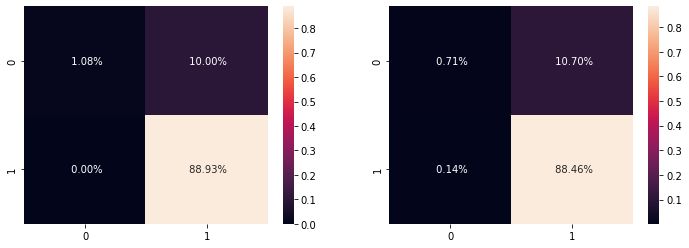

In [ ]:
# Create the confusion matrix for Logistic regression.

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics


print("Confusion matrix for train and test set")

plt.figure(figsize=(12,4))

plt.subplot(1,2,1)

# confusion matrix for train set
cm_train = metrics.confusion_matrix(y_train, y_pred_train)
sns.heatmap(cm_train/np.sum(cm_train), annot=True , fmt = ' .2%')

plt.subplot(1,2,2)

# confusion matrix for the test data
cm_test = metrics.confusion_matrix(y_test, y_pred_test)
sns.heatmap(cm_test/np.sum(cm_test), annot=True , fmt = ' .2%')

plt.show()

In [ ]:
# storing the values in variables  

#For train set: TN: True Negative, FP: False Positive, FN: False Negative, TP: True Positive
TN_tr = cm_train[0, 0] 
FP_tr = cm_train[0, 1]
FN_tr = cm_train[1, 0]
TP_tr = cm_train[1, 1]

#for test set
TN = cm_test[0, 0]
FP = cm_test[0, 1]
FN = cm_test[1, 0]
TP = cm_test[1, 1]


Sensitivity (True Positive Rate) is a measure of the proportion of actual positive cases that got predicted as positive.

Specificity (True Negative Rate) is defined as the proportion of actual negatives, which got predicted as the negative (or true negative).


True Positive Rate = True Positives / (True Positives + False Negatives)

False Positive Rate = False Positives / (False Positives + True Negatives)

The metrics that have been chosen are sensitivity and specificity. As you need to have more sensitivity as well as specificity.

In [ ]:
#Calculating the Sensitivity for train and test set
sensitivity_tr = TP_tr / float(FN_tr + TP_tr)
print("sensitivity for train set: ",sensitivity_tr)
sensitivity = TP / float(FN + TP)
print("sensitivity for test set: ",sensitivity)

sensitivity for train set:  1.0
sensitivity for test set:  0.9984728938661237


In [ ]:
#specificity for test and train set. 
specificity_tr = TN_tr / float(TN_tr + FP_tr)
print("specificity for train set: ",specificity_tr)
specificity = TN / float(TN + FP)
print("specificity for test set: ",specificity)

specificity for train set:  0.09729493891797557
specificity for test set:  0.06225296442687747


Since the distribution of the dataset is imbalanced with more positives, many reviews which were negative were incorrectly classified as positives and hence, low specificity. From a business point of view, this is not a very good model as you will miss out on the negatives.

####**Logistic Regression Model : With Sampling Techniques**

We can use different Sampling Techniques like -

1. Oversampling
2. Smote

In [ ]:
# Split test and train
seed = 50 

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=seed)

In [ ]:
#from imblearn import over_sampling
from imblearn import over_sampling
ros = over_sampling.RandomOverSampler(random_state=0)

In [ ]:
# Oversampling the dataset.
X_train, y_train = ros.fit_resample(pd.DataFrame(X_train), pd.Series(y_train))

In [ ]:
pd.Series(y_train).value_counts()

1    18404
0    18404
Name: user_sentiment, dtype: int64

In [ ]:
type(X_train)

pandas.core.frame.DataFrame

In [ ]:
# The word vectorizer takes a list of string as an argument. to get a list of string from a 2D array,
# we convert the 2D array to a dataframe and then convert it to a list.

X_train = pd.DataFrame(X_train).iloc[:,0].tolist()

In [ ]:
# transforming the train and test datasets

X_train_transformed = word_vectorizer.transform(X_train)
X_test_transformed = word_vectorizer.transform(X_test.tolist())

In [ ]:
# Building the Logistic Regression model
time1 = time.time()

logit = LogisticRegression()
logit.fit(X_train_transformed,y_train)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Time Taken: 11.72 seconds


In [ ]:
# Prediction Train Data
y_pred_train= logit.predict(X_train_transformed)

#Model Performance on Train Dataset
print("Logistic Regression accuracy", accuracy_score(y_pred_train, y_train))
print(classification_report(y_pred_train, y_train))

Logistic Regression accuracy 0.9899206694196914
              precision    recall  f1-score   support

           0       1.00      0.98      0.99     18737
           1       0.98      1.00      0.99     18071

    accuracy                           0.99     36808
   macro avg       0.99      0.99      0.99     36808
weighted avg       0.99      0.99      0.99     36808



In [ ]:
# Prediction Test Data
y_pred_test = logit.predict(X_test_transformed)

print("Logistic Regression accuracy", accuracy_score(y_pred_test, y_test))
print(classification_report(y_pred_test, y_test))
print(confusion_matrix(y_pred_test, y_test))

Logistic Regression accuracy 0.9076662908680947
              precision    recall  f1-score   support

           0       0.53      0.61      0.57       883
           1       0.96      0.94      0.95      7987

    accuracy                           0.91      8870
   macro avg       0.74      0.77      0.76      8870
weighted avg       0.91      0.91      0.91      8870

[[ 538  345]
 [ 474 7513]]


Confusion matrix for train and test set


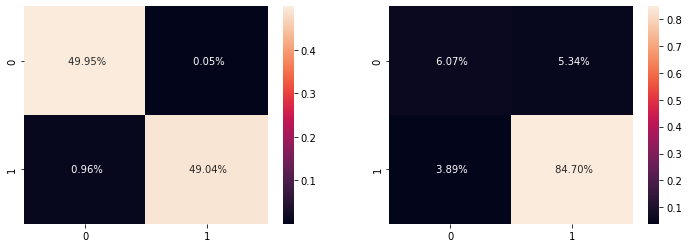

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics


print("Confusion matrix for train and test set")

plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
# confusion matrix for train set
cm_train = metrics.confusion_matrix(y_train, y_pred_train)
sns.heatmap(cm_train/np.sum(cm_train), annot=True , fmt = ' .2%')
# help(metrics.confusion_matrix)

plt.subplot(1,2,2)
# confusion matrix for the test data
cm_test = metrics.confusion_matrix(y_test, y_pred_test)
sns.heatmap(cm_test/np.sum(cm_test), annot=True , fmt = ' .2%')

plt.show()

In [ ]:
# storing the values in variables  

#For train set
TN_tr = cm_train[0, 0] 
FP_tr = cm_train[0, 1]
FN_tr = cm_train[1, 0]
TP_tr = cm_train[1, 1]

#for test set
TN = cm_test[0, 0]
FP = cm_test[0, 1]
FN = cm_test[1, 0]
TP = cm_test[1, 1]


In [ ]:
#Calculating the Sensitivity for train and test set
sensitivity_tr = TP_tr / float(FN_tr + TP_tr)
print("sensitivity for train set: ",sensitivity_tr)
sensitivity = TP / float(FN + TP)
print("sensitivity for test set: ",sensitivity)

sensitivity for train set:  0.9808737231036732
sensitivity for test set:  0.9560956986510563


In [ ]:
#specificity for test and train set. 
specificity_tr = TN_tr / float(TN_tr + FP_tr)
print("specificity for train set: ",specificity_tr)
specificity = TN / float(TN + FP)
print("specificity for test set: ",specificity)

specificity for train set:  0.9989676157357096
specificity for test set:  0.5316205533596838


As you can see here that the value of specificity has increased hence, you need to use oversampling method.

####**Logistic Regression Model: Smote**


In [ ]:
# Split test and train
seed = 50 

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=seed)

In [ ]:
# Print the type of X_train.
type(X_train)

pandas.core.series.Series

In [ ]:
pd.Series(y_train).value_counts()

1    18404
0     2292
Name: user_sentiment, dtype: int64

In [ ]:
type(X_train)

pandas.core.series.Series

In [ ]:
# The word vectorizer takes a list of string as an argument. to get a list of string from a 2D array,
# we convert the 2D array to a dataframe and then convert it to a list.

X_train = pd.DataFrame(X_train).iloc[:,0].tolist()

In [ ]:
type(X_train)

list

In [ ]:
# transforming the train and test datasets

X_train_transformed = word_vectorizer.transform(X_train)
X_test_transformed = word_vectorizer.transform(X_test.tolist())

In [ ]:
from imblearn.over_sampling import SMOTE

counter = Counter(y_train)
print('Before',counter)

# oversampling the train dataset using SMOTE
smt = SMOTE()
X_train_transformed, y_train = smt.fit_resample(X_train_transformed, y_train)

counter = Counter(y_train)
print('After',counter)

Before Counter({1: 18404, 0: 2292})
After Counter({1: 18404, 0: 18404})


In [ ]:
# Building the Logistic Regression model
time1 = time.time()

logit = LogisticRegression()
logit.fit(X_train_transformed,y_train)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Time Taken: 9.53 seconds


In [ ]:
# Prediction Train Data
y_pred_train= logit.predict(X_train_transformed)

#Model Performance on Train Dataset
print("Logistic Regression accuracy", accuracy_score(y_pred_train, y_train))
print(classification_report(y_pred_train, y_train))

Logistic Regression accuracy 0.9885894370788959
              precision    recall  f1-score   support

           0       1.00      0.98      0.99     18734
           1       0.98      1.00      0.99     18074

    accuracy                           0.99     36808
   macro avg       0.99      0.99      0.99     36808
weighted avg       0.99      0.99      0.99     36808



In [ ]:
# Prediction Test Data
y_pred_test = logit.predict(X_test_transformed)

print("Logistic Regression accuracy", accuracy_score(y_pred_test, y_test))
print(classification_report(y_pred_test, y_test))
print(confusion_matrix(y_pred_test, y_test))

Logistic Regression accuracy 0.905749718151071
              precision    recall  f1-score   support

           0       0.53      0.60      0.56       906
           1       0.95      0.94      0.95      7964

    accuracy                           0.91      8870
   macro avg       0.74      0.77      0.76      8870
weighted avg       0.91      0.91      0.91      8870

[[ 541  365]
 [ 471 7493]]


Confusion matrix for train and test set


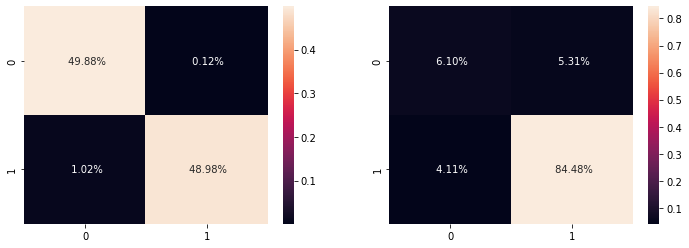

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics


print("Confusion matrix for train and test set")

plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
# confusion matrix for train set
cm_train = metrics.confusion_matrix(y_train, y_pred_train)
sns.heatmap(cm_train/np.sum(cm_train), annot=True , fmt = ' .2%')
# help(metrics.confusion_matrix)

plt.subplot(1,2,2)
# confusion matrix for the test data
cm_test = metrics.confusion_matrix(y_test, y_pred_test)
sns.heatmap(cm_test/np.sum(cm_test), annot=True , fmt = ' .2%')

plt.show()

In [ ]:
# storing the values in variables  

#For train set
TN_tr = cm_train[0, 0] 
FP_tr = cm_train[0, 1]
FN_tr = cm_train[1, 0]
TP_tr = cm_train[1, 1]

#for test set
TN = cm_test[0, 0]
FP = cm_test[0, 1]
FN = cm_test[1, 0]
TP = cm_test[1, 1]


In [ ]:
#Calculating the Sensitivity for train and test set
sensitivity_tr = TP_tr / float(FN_tr + TP_tr)
print("sensitivity for train set: ",sensitivity_tr)
sensitivity = TP / float(FN + TP)
print("sensitivity for test set: ",sensitivity)

sensitivity for train set:  0.9796239947837426
sensitivity for test set:  0.9535505217612624


In [ ]:
#specificity for test and train set. 
specificity_tr = TN_tr / float(TN_tr + FP_tr)
print("specificity for train set: ",specificity_tr)
specificity = TN / float(TN + FP)
print("specificity for test set: ",specificity)

specificity for train set:  0.9975548793740491
specificity for test set:  0.5345849802371542


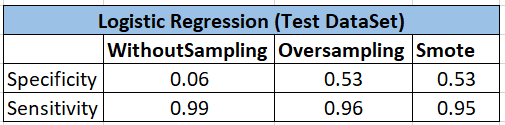

### **Naive Bayes**

####**Naive Bayes Model: Oversampling**


In [ ]:
from imblearn import over_sampling
ros = over_sampling.RandomOverSampler(random_state=0)

In [ ]:
# Split test and train
seed = 50 

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=seed)

In [ ]:
# Print the type of X_train.
type(X_train)

pandas.core.series.Series

In [ ]:
# Oversampling the dataset.
X_train, y_train = ros.fit_resample(pd.DataFrame(X_train), pd.Series(y_train))

In [ ]:
pd.Series(y_train).value_counts()

1    18404
0    18404
Name: user_sentiment, dtype: int64

In [ ]:
type(X_train)

pandas.core.frame.DataFrame

In [ ]:
# The word vectorizer takes a list of string as an argument. to get a list of string from a 2D array,
# we convert the 2D array to a dataframe and then convert it to a list.

X_train = pd.DataFrame(X_train).iloc[:,0].tolist()

In [ ]:
type(X_train)

list

In [ ]:
# transforming the train and test datasets

X_train_transformed = word_vectorizer.transform(X_train)
X_test_transformed = word_vectorizer.transform(X_test.tolist())

In [ ]:
# Build the Naive Bayes model.

from sklearn.naive_bayes import MultinomialNB
mnb = MultinomialNB()

time1 = time.time()

mnb = MultinomialNB()
mnb.fit(X_train_transformed,y_train)


time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Time Taken: 0.05 seconds


In [ ]:
# Prediction Train Data
y_pred_train = mnb.predict(X_train_transformed)

print("Naive Bayes accuracy", accuracy_score(y_pred_train , y_train))
print(classification_report(y_pred_train , y_train))

Naive Bayes accuracy 0.983101499673984
              precision    recall  f1-score   support

           0       1.00      0.97      0.98     18952
           1       0.97      1.00      0.98     17856

    accuracy                           0.98     36808
   macro avg       0.98      0.98      0.98     36808
weighted avg       0.98      0.98      0.98     36808



In [ ]:
# Prediction Test Data
y_pred_test  = mnb.predict(X_test_transformed)

print("Naive Bayes accuracy", accuracy_score(y_pred_test , y_test))
print(classification_report(y_pred_test , y_test))

Naive Bayes accuracy 0.8618940248027057
              precision    recall  f1-score   support

           0       0.57      0.42      0.48      1363
           1       0.90      0.94      0.92      7507

    accuracy                           0.86      8870
   macro avg       0.73      0.68      0.70      8870
weighted avg       0.85      0.86      0.85      8870



Confusion matrix for train and test set


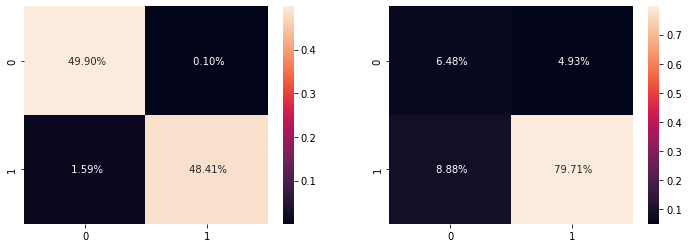

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics


print("Confusion matrix for train and test set")

plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
# confusion matrix for train set
cm_train = metrics.confusion_matrix(y_train, y_pred_train)
sns.heatmap(cm_train/np.sum(cm_train), annot=True , fmt = ' .2%')
# help(metrics.confusion_matrix)

plt.subplot(1,2,2)
# confusion matrix for the test data
cm_test = metrics.confusion_matrix(y_test, y_pred_test)
sns.heatmap(cm_test/np.sum(cm_test), annot=True , fmt = ' .2%')

plt.show()

In [ ]:
# storing the values in variables  

#For train set
TN_tr = cm_train[0, 0] 
FP_tr = cm_train[0, 1]
FN_tr = cm_train[1, 0]
TP_tr = cm_train[1, 1]

#for test set
TN = cm_test[0, 0]
FP = cm_test[0, 1]
FN = cm_test[1, 0]
TP = cm_test[1, 1]


In [ ]:
#Calculating the Sensitivity for train and test set
sensitivity_tr = TP_tr / float(FN_tr + TP_tr)
print("sensitivity for train set: ",sensitivity_tr)
sensitivity = TP / float(FN + TP)
print("sensitivity for test set: ",sensitivity)

sensitivity for train set:  0.9682134318626385
sensitivity for test set:  0.8997200305421227


In [ ]:
#specificity for test and train set. 
specificity_tr = TN_tr / float(TN_tr + FP_tr)
print("specificity for train set: ",specificity_tr)
specificity = TN / float(TN + FP)
print("specificity for test set: ",specificity)

specificity for train set:  0.9979895674853293
specificity for test set:  0.5681818181818182


### **Random Forest Classifier**

#### **Random Forest Model: Oversampling** 


In [ ]:
#from imblearn import over_sampling
from imblearn import over_sampling
ros = over_sampling.RandomOverSampler(random_state=0)

In [ ]:
# Split test and train
seed = 50 

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=seed)

In [ ]:
# Print the type of X_train.
type(X_train)

pandas.core.series.Series

In [ ]:
# Oversampling the dataset.
X_train, y_train = ros.fit_resample(pd.DataFrame(X_train), pd.Series(y_train))

In [ ]:
pd.Series(y_train).value_counts()

1    18404
0    18404
Name: user_sentiment, dtype: int64

In [ ]:
type(X_train)

pandas.core.frame.DataFrame

In [ ]:
# The word vectorizer takes a list of string as an argument. to get a list of string from a 2D array,
# we convert the 2D array to a dataframe and then convert it to a list.

X_train = pd.DataFrame(X_train).iloc[:,0].tolist()

In [ ]:
type(X_train)

list

In [ ]:
# transforming the train and test datasets

X_train_transformed = word_vectorizer.transform(X_train)
X_test_transformed = word_vectorizer.transform(X_test.tolist())

In [ ]:
# Building Random Forest Model.
time1 = time.time()

classifier = RandomForestClassifier(n_estimators=50, random_state=seed, n_jobs=-1)
classifier.fit(X_train_transformed,y_train)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Time Taken: 98.48 seconds


In [ ]:
# Prediction Train Data
y_pred_train= classifier.predict(X_train_transformed)

print("Random Forest Model accuracy", accuracy_score(y_pred_train, y_train))
print(classification_report(y_pred_train, y_train))

Random Forest Model accuracy 0.99994566398609
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     18406
           1       1.00      1.00      1.00     18402

    accuracy                           1.00     36808
   macro avg       1.00      1.00      1.00     36808
weighted avg       1.00      1.00      1.00     36808



In [ ]:
# Prediction Test Data
y_pred_test = classifier.predict(X_test_transformed)

print("Random Forest Model accuracy", accuracy_score(y_pred_test, y_test))
print(classification_report(y_pred_test, y_test))


Random Forest Model accuracy 0.9090191657271702
              precision    recall  f1-score   support

           0       0.29      0.77      0.42       383
           1       0.99      0.92      0.95      8487

    accuracy                           0.91      8870
   macro avg       0.64      0.84      0.69      8870
weighted avg       0.96      0.91      0.93      8870



Confusion matrix for train and test set


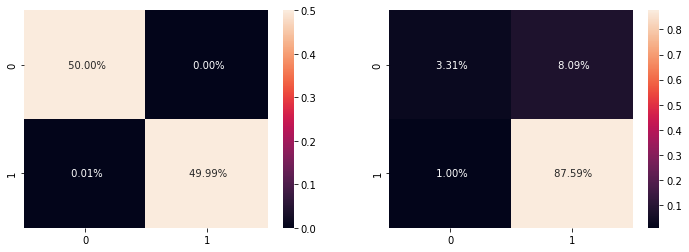

In [ ]:
# Create the confusion matrix for Random Forest.

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics


print("Confusion matrix for train and test set")

plt.figure(figsize=(12,4))

plt.subplot(1,2,1)

# confusion matrix for train set
cm_train = metrics.confusion_matrix(y_train, y_pred_train)
sns.heatmap(cm_train/np.sum(cm_train), annot=True , fmt = ' .2%')
# help(metrics.confusion_matrix)

plt.subplot(1,2,2)

# confusion matrix for the test data
cm_test = metrics.confusion_matrix(y_test, y_pred_test)
sns.heatmap(cm_test/np.sum(cm_test), annot=True , fmt = ' .2%')

plt.show()

In [ ]:
# storing the values in variables  

#For train set: TN: True Negative, FP: False Positive, FN: False Negative, TP: True Positive
TN_tr = cm_train[0, 0] 
FP_tr = cm_train[0, 1]
FN_tr = cm_train[1, 0]
TP_tr = cm_train[1, 1]

#for test set
TN = cm_test[0, 0]
FP = cm_test[0, 1]
FN = cm_test[1, 0]
TP = cm_test[1, 1]


In [ ]:
#Calculating the Sensitivity for train and test set
sensitivity_tr = TP_tr / float(FN_tr + TP_tr)
print("sensitivity for train set: ",sensitivity_tr)
sensitivity = TP / float(FN + TP)
print("sensitivity for test set: ",sensitivity)

sensitivity for train set:  0.9998913279721799
sensitivity for test set:  0.9886739628404174


In [ ]:
#specificity for test and train set. 
specificity_tr = TN_tr / float(TN_tr + FP_tr)
print("specificity for train set: ",specificity_tr)
specificity = TN / float(TN + FP)
print("specificity for test set: ",specificity)

specificity for train set:  1.0
specificity for test set:  0.29051383399209485


### **XGBoost**

####**XGBoost Model: Oversampling**


In [ ]:
#from imblearn import over_sampling
from imblearn import over_sampling
ros = over_sampling.RandomOverSampler(random_state=0)

In [ ]:
# Split test and train
seed = 50 

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=seed)

In [ ]:
# Print the type of X_train.
type(X_train)

pandas.core.series.Series

In [ ]:
# Oversampling the dataset.
X_train, y_train = ros.fit_resample(pd.DataFrame(X_train), pd.Series(y_train))

In [ ]:
pd.Series(y_train).value_counts()

1    18404
0    18404
Name: user_sentiment, dtype: int64

In [ ]:
type(X_train)

pandas.core.frame.DataFrame

In [ ]:
# The word vectorizer takes a list of string as an argument. to get a list of string from a 2D array,
# we convert the 2D array to a dataframe and then convert it to a list.

X_train = pd.DataFrame(X_train).iloc[:,0].tolist()

In [ ]:
type(X_train)

list

In [ ]:
# transforming the train and test datasets

X_train_transformed = word_vectorizer.transform(X_train)
X_test_transformed = word_vectorizer.transform(X_test.tolist())

In [ ]:
# Building the XGBoost model
import xgboost as xgb
time1 = time.time()

xgb = xgb.XGBClassifier(n_jobs=-1)
xgb.fit(X_train_transformed,y_train)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Time Taken: 47.42 seconds


In [ ]:
# Prediction Train Data
y_pred_train  = xgb.predict(X_train_transformed)

print("XGBoost Model accuracy", accuracy_score(y_pred_train, y_train))
print(classification_report(y_pred_train, y_train))

XGBoost Model accuracy 0.8132742881982178
              precision    recall  f1-score   support

           0       0.83      0.80      0.82     19053
           1       0.80      0.82      0.81     17755

    accuracy                           0.81     36808
   macro avg       0.81      0.81      0.81     36808
weighted avg       0.81      0.81      0.81     36808



In [ ]:
# Prediction Test Data
y_pred_test  = xgb.predict(X_test_transformed)

print("XGBoost Model accuracy", accuracy_score(y_pred_test, y_test))
print(classification_report(y_pred_test, y_test))

XGBoost Model accuracy 0.7880496054114995
              precision    recall  f1-score   support

           0       0.73      0.32      0.44      2352
           1       0.80      0.96      0.87      6518

    accuracy                           0.79      8870
   macro avg       0.76      0.64      0.66      8870
weighted avg       0.78      0.79      0.76      8870



Confusion matrix for train and test set


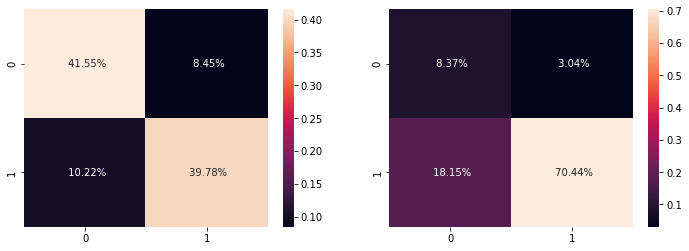

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics


print("Confusion matrix for train and test set")

plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
# confusion matrix for train set
cm_train = metrics.confusion_matrix(y_train, y_pred_train)
sns.heatmap(cm_train/np.sum(cm_train), annot=True , fmt = ' .2%')
# help(metrics.confusion_matrix)

plt.subplot(1,2,2)
# confusion matrix for the test data
cm_test = metrics.confusion_matrix(y_test, y_pred_test)
sns.heatmap(cm_test/np.sum(cm_test), annot=True , fmt = ' .2%')

plt.show()

In [ ]:
# storing the values in variables  

#For train set
TN_tr = cm_train[0, 0] 
FP_tr = cm_train[0, 1]
FN_tr = cm_train[1, 0]
TP_tr = cm_train[1, 1]

#for test set
TN = cm_test[0, 0]
FP = cm_test[0, 1]
FN = cm_test[1, 0]
TP = cm_test[1, 1]


In [ ]:
#Calculating the Sensitivity for train and test set
sensitivity_tr = TP_tr / float(FN_tr + TP_tr)
print("sensitivity for train set: ",sensitivity_tr)
sensitivity = TP / float(FN + TP)
print("sensitivity for test set: ",sensitivity)

sensitivity for train set:  0.7956422516844164
sensitivity for test set:  0.7951132603715958


In [ ]:
#specificity for test and train set. 
specificity_tr = TN_tr / float(TN_tr + FP_tr)
print("specificity for train set: ",specificity_tr)
specificity = TN / float(TN + FP)
print("specificity for test set: ",specificity)

specificity for train set:  0.8309063247120191
specificity for test set:  0.733201581027668


### **Hyper Parameter Tuning On Oversampled Data** 




#### Random Forest

In [ ]:
from imblearn import over_sampling
ros = over_sampling.RandomOverSampler(random_state=0)

In [ ]:
# Split test and train
seed = 50 

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=seed)

In [ ]:
# Print the type of X_train.
type(X_train)

pandas.core.series.Series

In [ ]:
# Oversampling the dataset.
X_train, y_train = ros.fit_resample(pd.DataFrame(X_train), pd.Series(y_train))

In [ ]:
pd.Series(y_train).value_counts()

1    18404
0    18404
Name: user_sentiment, dtype: int64

In [ ]:
type(X_train)

pandas.core.frame.DataFrame

In [ ]:
# The word vectorizer takes a list of string as an argument. to get a list of string from a 2D array,
# we convert the 2D array to a dataframe and then convert it to a list.

X_train = pd.DataFrame(X_train).iloc[:,0].tolist()

In [ ]:
type(X_train)

list

In [ ]:
# transforming the train and test datasets

X_train_transformed = word_vectorizer.transform(X_train)
X_test_transformed = word_vectorizer.transform(X_test.tolist())

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
X_train_transformed,y_train
# Building Random Forest Model.
time1 = time.time()

n_estimators = [10,20,30] 
max_features = ['auto', 'sqrt']
max_depth = [4,5,6]
max_depth.append(None) # If None, then nodes are expanded until all leaves are pure or until all leaves contain less than min_samples_split samples.
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]

random_grid = {'n_estimators': n_estimators, 'max_features': max_features,
               'max_depth': max_depth, 'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}

rf_classifier = RandomForestClassifier(random_state=42)

rf_final = RandomizedSearchCV(estimator=rf_classifier, param_distributions=random_grid, n_iter=5, cv=3, 
                               verbose=2, random_state=42, n_jobs=-1)


rf_final.fit(X_train_transformed,y_train)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Fitting 3 folds for each of 5 candidates, totalling 15 fits
Time Taken: 85.23 seconds


In [ ]:
rf_final.best_estimator_

RandomForestClassifier(max_features='sqrt', min_samples_leaf=2,
                       min_samples_split=5, n_estimators=10, random_state=42)

In [ ]:
# Prediction Train Data
y_pred_train= rf_final.predict(X_train_transformed)

print("Random Forest Model accuracy", accuracy_score(y_pred_train, y_train))
print(classification_report(y_pred_train, y_train))

Random Forest Model accuracy 0.9677515757444034
              precision    recall  f1-score   support

           0       0.97      0.97      0.97     18403
           1       0.97      0.97      0.97     18405

    accuracy                           0.97     36808
   macro avg       0.97      0.97      0.97     36808
weighted avg       0.97      0.97      0.97     36808



In [ ]:
# Prediction Test Data
y_pred_test = rf_final.predict(X_test_transformed)

print("Random Forest Model accuracy", accuracy_score(y_pred_test, y_test))
print(classification_report(y_pred_test, y_test))


Random Forest Model accuracy 0.8777903043968432
              precision    recall  f1-score   support

           0       0.52      0.47      0.49      1124
           1       0.92      0.94      0.93      7746

    accuracy                           0.88      8870
   macro avg       0.72      0.70      0.71      8870
weighted avg       0.87      0.88      0.88      8870



Confusion matrix for train and test set


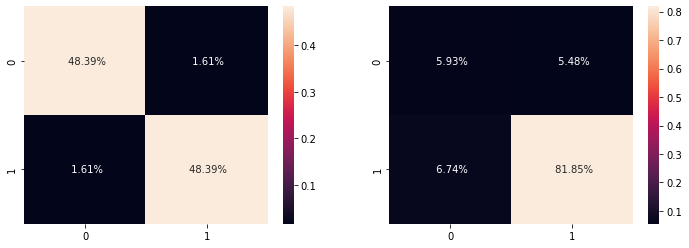

In [ ]:
# Create the confusion matrix for Random Forest.

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics


print("Confusion matrix for train and test set")

plt.figure(figsize=(12,4))

plt.subplot(1,2,1)

# confusion matrix for train set
cm_train = metrics.confusion_matrix(y_train, y_pred_train)
sns.heatmap(cm_train/np.sum(cm_train), annot=True , fmt = ' .2%')
# help(metrics.confusion_matrix)

plt.subplot(1,2,2)

# confusion matrix for the test data
cm_test = metrics.confusion_matrix(y_test, y_pred_test)
sns.heatmap(cm_test/np.sum(cm_test), annot=True , fmt = ' .2%')

plt.show()

In [ ]:
# storing the values in variables  

#For train set: TN: True Negative, FP: False Positive, FN: False Negative, TP: True Positive
TN_tr = cm_train[0, 0] 
FP_tr = cm_train[0, 1]
FN_tr = cm_train[1, 0]
TP_tr = cm_train[1, 1]

#for test set
TN = cm_test[0, 0]
FP = cm_test[0, 1]
FN = cm_test[1, 0]
TP = cm_test[1, 1]


In [ ]:
#Calculating the Sensitivity for train and test set
sensitivity_tr = TP_tr / float(FN_tr + TP_tr)
print("sensitivity for train set: ",sensitivity_tr)
sensitivity = TP / float(FN + TP)
print("sensitivity for test set: ",sensitivity)

sensitivity for train set:  0.9677787437513584
sensitivity for test set:  0.9238992109951641


In [ ]:
#specificity for test and train set. 
specificity_tr = TN_tr / float(TN_tr + FP_tr)
print("specificity for train set: ",specificity_tr)
specificity = TN / float(TN + FP)
print("specificity for test set: ",specificity)

specificity for train set:  0.9677244077374484
specificity for test set:  0.5197628458498024


#### Xgboost

In [ ]:
#from imblearn import over_sampling
from imblearn import over_sampling
ros = over_sampling.RandomOverSampler(random_state=0)

In [ ]:
# Split test and train
seed = 50 

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=seed)

In [ ]:
# Print the type of X_train.
type(X_train)

pandas.core.series.Series

In [ ]:
# Oversampling the dataset.
X_train, y_train = ros.fit_resample(pd.DataFrame(X_train), pd.Series(y_train))

In [ ]:
pd.Series(y_train).value_counts()

1    18404
0    18404
Name: user_sentiment, dtype: int64

In [ ]:
type(X_train)

pandas.core.frame.DataFrame

In [ ]:
# The word vectorizer takes a list of string as an argument. to get a list of string from a 2D array,
# we convert the 2D array to a dataframe and then convert it to a list.

X_train = pd.DataFrame(X_train).iloc[:,0].tolist()

In [ ]:
type(X_train)

list

In [ ]:
# transforming the train and test datasets

X_train_transformed = word_vectorizer.transform(X_train)
X_test_transformed = word_vectorizer.transform(X_test.tolist())

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
# Building Xgboost Model.
time1 = time.time()

import xgboost as xgb 
n_estimators = [10,15,20,25,30] 
max_features = ['auto', 'sqrt']
max_depth = [4,5,6]
max_depth.append(None) # If None, then nodes are expanded until all leaves are pure or until all leaves contain less than min_samples_split samples.
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]

random_grid = {'n_estimators': n_estimators, 'max_features': max_features,
               'max_depth': max_depth, 'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}

xgb = xgb.XGBClassifier(n_jobs=-1)

xgb_final = RandomizedSearchCV(estimator=xgb, param_distributions=random_grid, n_iter=5, cv=3, 
                               verbose=2, random_state=42, n_jobs=-1)


xgb_final.fit(X_train_transformed,y_train)

time_taken = time.time() - time1
print('Time Taken: {:.2f} seconds'.format(time_taken))

Fitting 3 folds for each of 5 candidates, totalling 15 fits
Time Taken: 190.32 seconds


In [ ]:
xgb_final.best_estimator_

XGBClassifier(max_depth=6, max_features='auto', min_samples_leaf=4,
              min_samples_split=10, n_estimators=30, n_jobs=-1)

In [ ]:
# Prediction Train Data
y_pred_train= xgb_final.predict(X_train_transformed)

print("Xgboost Forest Model accuracy", accuracy_score(y_pred_train, y_train))
print(classification_report(y_pred_train, y_train))

Xgboost Forest Model accuracy 0.8227015866116062
              precision    recall  f1-score   support

           0       0.86      0.80      0.83     19750
           1       0.79      0.85      0.82     17058

    accuracy                           0.82     36808
   macro avg       0.82      0.82      0.82     36808
weighted avg       0.83      0.82      0.82     36808



In [ ]:
# Prediction Test Data
y_pred_test = xgb_final.predict(X_test_transformed)

print("Xgboost Model accuracy", accuracy_score(y_pred_test, y_test))
print(classification_report(y_pred_test, y_test))


Xgboost Model accuracy 0.7728297632468997
              precision    recall  f1-score   support

           0       0.74      0.30      0.43      2501
           1       0.78      0.96      0.86      6369

    accuracy                           0.77      8870
   macro avg       0.76      0.63      0.64      8870
weighted avg       0.77      0.77      0.74      8870



Confusion matrix for train and test set


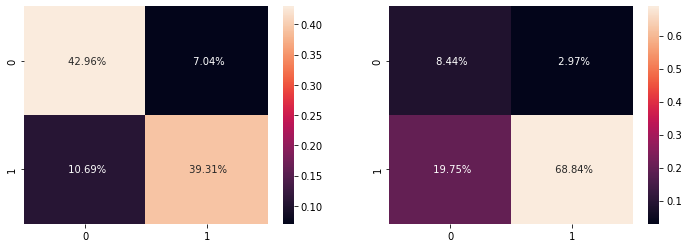

In [ ]:
# Create the confusion matrix for Random Forest.

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics


print("Confusion matrix for train and test set")

plt.figure(figsize=(12,4))

plt.subplot(1,2,1)

# confusion matrix for train set
cm_train = metrics.confusion_matrix(y_train, y_pred_train)
sns.heatmap(cm_train/np.sum(cm_train), annot=True , fmt = ' .2%')
# help(metrics.confusion_matrix)

plt.subplot(1,2,2)

# confusion matrix for the test data
cm_test = metrics.confusion_matrix(y_test, y_pred_test)
sns.heatmap(cm_test/np.sum(cm_test), annot=True , fmt = ' .2%')

plt.show()

In [ ]:
# storing the values in variables  

#For train set: TN: True Negative, FP: False Positive, FN: False Negative, TP: True Positive
TN_tr = cm_train[0, 0] 
FP_tr = cm_train[0, 1]
FN_tr = cm_train[1, 0]
TP_tr = cm_train[1, 1]

#for test set
TN = cm_test[0, 0]
FP = cm_test[0, 1]
FN = cm_test[1, 0]
TP = cm_test[1, 1]


In [ ]:
#Calculating the Sensitivity for train and test set
sensitivity_tr = TP_tr / float(FN_tr + TP_tr)
print("sensitivity for train set: ",sensitivity_tr)
sensitivity = TP / float(FN + TP)
print("sensitivity for test set: ",sensitivity)

sensitivity for train set:  0.786133449250163
sensitivity for test set:  0.7770425044540595


In [ ]:
#specificity for test and train set. 
specificity_tr = TN_tr / float(TN_tr + FP_tr)
print("specificity for train set: ",specificity_tr)
specificity = TN / float(TN + FP)
print("specificity for test set: ",specificity)

specificity for train set:  0.8592697239730493
specificity for test set:  0.7401185770750988


#### Machine Learning - Sentiment Model Evaluation Summary

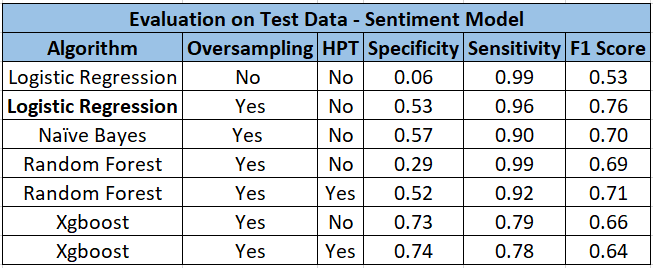

## **Recommendation System**

### **Test and Train Split**

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29566 entries, 0 to 29999
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   id              29566 non-null  object
 1   brand           29566 non-null  object
 2   categories      29566 non-null  object
 3   manufacturer    29566 non-null  object
 4   prod_name       29566 non-null  object
 5   reviews_date    29566 non-null  object
 6   reviews_rating  29566 non-null  int64 
 7   reviews_text    29566 non-null  object
 8   reviews_title   29566 non-null  object
 9   userID          29566 non-null  object
 10  user_sentiment  29566 non-null  int64 
 11  Review          29566 non-null  object
dtypes: int64(2), object(10)
memory usage: 4.2+ MB


In [ ]:
# Getting only relevant columns
df1 = df[["userID","reviews_rating","prod_name"]]

In [ ]:
#Check the NULL count:
df1.isnull().any()

userID            False
reviews_rating    False
prod_name         False
dtype: bool

In [ ]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29566 entries, 0 to 29999
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   userID          29566 non-null  object
 1   reviews_rating  29566 non-null  int64 
 2   prod_name       29566 non-null  object
dtypes: int64(1), object(2)
memory usage: 2.2+ MB


In [ ]:
df1.head(2)

,userID,reviews_rating,prod_name
0,joshua,5,Pink Friday: Roman Reloaded Re-Up (w/dvd)
1,dorothy w,5,Lundberg Organic Cinnamon Toast Rice Cakes


#### Dividing the dataset into train and test

In [ ]:
from sklearn.model_selection import train_test_split
train, test = train_test_split(df1, test_size=0.30, random_state=31)

In [ ]:
print(train.shape)
print(test.shape)

(20696, 3)
(8870, 3)


#### Dummy Train creation for end prediciton.

These dataset will be used for prediction and evaluation.

Dummy train will be used later for prediction of the movies which has not been rated by the user. To ignore the movies rated by the user, we will mark it as 0 during prediction. The movies not rated by user is marked as 1 for prediction.

In [ ]:
dummy_train = train.copy()

In [ ]:
# Remove this part
dummy_train['reviews_rating'] = dummy_train['reviews_rating'].apply(lambda x: 0 if x>=1 else 1)

In [ ]:
dummy_train.head()

,userID,reviews_rating,prod_name
29334,jhazobeaute23,0,L'or233al Paris Elvive Extraordinary Clay Rebalancing Conditioner - 12.6 Fl Oz
18672,abret,0,Clorox Disinfecting Bathroom Cleaner
14532,hgandee,0,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total
25152,bleepibityboop,0,Godzilla 3d Includes Digital Copy Ultraviolet 3d/2d Blu-Ray/dvd
9773,85lisa,0,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total


In [ ]:
# The products not rated by user is marked as 1 for prediction. And make the user- item matrix representaion.
dummy_train = dummy_train.pivot_table(index='userID', columns='prod_name', values='reviews_rating').fillna(1)

### **User Similarity Matrix**

#### **Using adjusted Cosine** 

We are not removing the NaN values and calculating the mean only for the movies rated by the user

In [ ]:
# Make the user- item matrix representaion of train dataset.
user_based_matrix = train.pivot_table(index='userID', columns='prod_name', values='reviews_rating')

In [ ]:
user_based_matrix.shape

(18061, 233)

Normalising the rating of the products for each user around 0 mean

In [ ]:
mean = np.nanmean(user_based_matrix, axis=1)
df_subtracted = (user_based_matrix.T-mean).T

In [ ]:
pd.options.display.max_columns = None
df_subtracted.sample()

prod_name,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,"2x Ultra Era with Oxi Booster, 50fl oz","42 Dual Drop Leaf Table with 2 Madrid Chairs""",4C Grated Parmesan Cheese 100% Natural 8oz Shaker,Africa's Best No-Lye Dual Conditioning Relaxer System Super,Alberto VO5 Salon Series Smooth Plus Sleek Shampoo,"All,bran Complete Wheat Flakes, 18 Oz.",Ambi Complexion Cleansing Bar,Annie's Homegrown Deluxe Elbows & Four Cheese Sauce,Annie's Homegrown Gluten Free Double Chocolate Chip Granola Bars,Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz","Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium",Barielle Nail Rebuilding Protein,Baxter Of California Cream Pomade,Bedtime Originals Pinkie Musical Mobile,"Ben & Jerry's Coffee, Coffee Buzzbuzzbuzz! Ice Cream, Pint",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bilbao Nightstand Gray Oak - South Shore,Bill Glor Gaither - Church In The Wildwood (cd),Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Black Sister's Revenge (dvd),Blue Anchor Design Throw Pillow (18x18) - Rizzy Home,Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets",Bumble Bee Solid White Albacore In Water - 5 Oz,"Burt's Bees Lip Shimmer, Raisin","Burt's Bees Lip Shimmer, Watermelon",Cal Lighting Led Dark Bronze Finish Metal Piano Lamp,Calvin Klein Secret Obsession Eau De Parfum,"Candy Pink Plastic Cups, 20 pk",Cantu Coconut Milk Shine Hold Mist - 8oz,Care Free Curl Gold Instant Activator,"Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan,CeraVe SA Renewing Cream,"Cetaphil Gentle Skin Cleanser, 2oz",Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chex Muddy Buddies Brownie Supreme Snack Mix,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chips Deluxe Soft 'n Chewy Cookies,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Clambake (dvd),Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,Clorox Ultimate Care Premium Bleach,Cococare 100% Natural Castor Oil,Concept Housewares 36 Natural Wood ceiling mounted pot rack,"Coty Airspun Face Powder, Translucent Extra Coverage","Creme Of Nature Intensive Conditioning Treatment, 32",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,"Dermalogica Special Cleansing Gel, 8.4oz",Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Disney174 Jake And The Neverland Pirates 4 Piece Bedding Set - Toddler,Doc Mcstuffins: Friendship Is The Best Medicine,Eagle Fat Free Sweetened Condensed Milk,Equals (blu-Ray),Feit 60-Watt A19 Gu24 Base Led Light Bulb - Soft White,"Finish Quantum Dishwasher Detergent, Lemon Sparkle Scent, 45 Count",Fiskars174 Classic Stick Rotary Cutter (45 Mm),Gain Original Scent Liquid Fabric Softener 129 Oz,Godzilla 3d Includes Digital Copy Ultraviolet 3d/2d Blu-Ray/dvd,Happy Tot Apple and Butternut Squash,Hawaiian Punch Berry Limeade Blast Juice,Head & Shoulders Classic Clean Conditioner,Head & Shoulders Dandruff Shampoo Ocean Lift 2 In 1,"Heinz Tomato Ketchup, 38oz",Heiress (dvd),Herr's Baked Cheese Curls,High-Dome Floor Door Stop,Hollywood Beauty Olive Cholesterol,Holmes174 Personal Indoor Heater W/ Manual Controls White 1500w Hfh131-N,Home H

Finding cosine similarity

In [ ]:
from sklearn.metrics.pairwise import pairwise_distances

# User Similarity Matrix: The correlation matrix of users.
user_correlation = 1 - pairwise_distances(df_subtracted.fillna(0), metric='cosine')
user_correlation[np.isnan(user_correlation)] = 0
print(user_correlation)

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [ ]:
np.shape(user_correlation)

(18061, 18061)

#### **Prediction**

Doing the prediction for the users which are positively related with other users, and not the users which are negatively related as we are interested in the users which are more similar to the current users. So, ignoring the correlation for values less than 0. 

In [ ]:
user_correlation[user_correlation<0]=0
user_correlation

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
user_correlation.shape

(18061, 18061)

Rating predicted by the user (for movies rated as well as not rated) is the weighted sum of correlation with the movie rating (as present in the rating dataset). 

In [ ]:
user_predicted_ratings = np.dot(user_correlation, user_based_matrix.fillna(0))
user_predicted_ratings

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
user_predicted_ratings.shape

(18061, 233)

#### Since we are interested only in the products not rated by the user, we will ignore the products rated by the user by making it zero. 

In [ ]:
user_final_rating = np.multiply(user_predicted_ratings,dummy_train)
user_final_rating.head()

prod_name,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,"2x Ultra Era with Oxi Booster, 50fl oz","42 Dual Drop Leaf Table with 2 Madrid Chairs""",4C Grated Parmesan Cheese 100% Natural 8oz Shaker,Africa's Best No-Lye Dual Conditioning Relaxer System Super,Alberto VO5 Salon Series Smooth Plus Sleek Shampoo,"All,bran Complete Wheat Flakes, 18 Oz.",Ambi Complexion Cleansing Bar,Annie's Homegrown Deluxe Elbows & Four Cheese Sauce,Annie's Homegrown Gluten Free Double Chocolate Chip Granola Bars,Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz","Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium",Barielle Nail Rebuilding Protein,Baxter Of California Cream Pomade,Bedtime Originals Pinkie Musical Mobile,"Ben & Jerry's Coffee, Coffee Buzzbuzzbuzz! Ice Cream, Pint",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bilbao Nightstand Gray Oak - South Shore,Bill Glor Gaither - Church In The Wildwood (cd),Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Black Sister's Revenge (dvd),Blue Anchor Design Throw Pillow (18x18) - Rizzy Home,Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets",Bumble Bee Solid White Albacore In Water - 5 Oz,"Burt's Bees Lip Shimmer, Raisin","Burt's Bees Lip Shimmer, Watermelon",Cal Lighting Led Dark Bronze Finish Metal Piano Lamp,Calvin Klein Secret Obsession Eau De Parfum,"Candy Pink Plastic Cups, 20 pk",Cantu Coconut Milk Shine Hold Mist - 8oz,Care Free Curl Gold Instant Activator,"Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan,CeraVe SA Renewing Cream,"Cetaphil Gentle Skin Cleanser, 2oz",Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chex Muddy Buddies Brownie Supreme Snack Mix,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chips Deluxe Soft 'n Chewy Cookies,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Clambake (dvd),Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,Clorox Ultimate Care Premium Bleach,Cococare 100% Natural Castor Oil,Concept Housewares 36 Natural Wood ceiling mounted pot rack,"Coty Airspun Face Powder, Translucent Extra Coverage","Creme Of Nature Intensive Conditioning Treatment, 32",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,"Dermalogica Special Cleansing Gel, 8.4oz",Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Disney174 Jake And The Neverland Pirates 4 Piece Bedding Set - Toddler,Doc Mcstuffins: Friendship Is The Best Medicine,Eagle Fat Free Sweetened Condensed Milk,Equals (blu-Ray),Feit 60-Watt A19 Gu24 Base Led Light Bulb - Soft White,"Finish Quantum Dishwasher Detergent, Lemon Sparkle Scent, 45 Count",Fiskars174 Classic Stick Rotary Cutter (45 Mm),Gain Original Scent Liquid Fabric Softener 129 Oz,Godzilla 3d Includes Digital Copy Ultraviolet 3d/2d Blu-Ray/dvd,Happy Tot Apple and Butternut Squash,Hawaiian Punch Berry Limeade Blast Juice,Head & Shoulders Classic Clean Conditioner,Head & Shoulders Dandruff Shampoo Ocean Lift 2 In 1,"Heinz Tomato Ketchup, 38oz",Heiress (dvd),Herr's Baked Cheese Curls,High-Dome Floor Door Stop,Hollywood Beauty Olive Cholesterol,Holmes174 Personal Indoor Heater W/ Manual Controls White 1500w Hfh131-N,Home H

### **Item Based Similarity**

#### **Using adjusted Cosine**

Using Correlation

Taking the transpose of the rating matrix to normalize the rating around the mean for different movie ID. In the user based similarity, we had taken mean for each user intead of each movie.

In [ ]:
item_based_matrix = train.pivot_table(index='userID', columns='prod_name', values='reviews_rating').T

In [ ]:
item_based_matrix.head(2)

userID,00dog3,01impala,02dakota,0325home,06stidriver,08dallas,09mommy11,1085,10ten,1143mom,1234,1234561,1234567,1234asdf,123cat123,123rs,123soccermom,123too,12cass12,132457,13ld,13ram,1421nikki,143st,148maine,1515,15425shopper,170361eggs,1753,18612,1863philly,1943,1968bear,1992firebirdgirl,19granny,1boomer,1cadet,1chynna,1clean1,1cocoafan,1derpet1,1disappoint,1friendlycat,1gamer,1gussy,1happymom,1hotmama,1izzy1,1jc1,1jodie,1kindword,1movielover2,1officegal,1okc2thunder3up4,1scooby1,1shop,1sonny,1stcavdivision,1stgrade,1stlady,1sungirl,1texasmom,1tomg,1vgarcia,1wildbill2l,1witch,2011pink2011,2013bestbuyer,2014bestbuys,2015mom,2016,2016home,2062351337,20crafter16,210tundra,2175046722,21please,23jen,2455,24hrstoneroses,2532674594,25happyshopper,262jennifer,2689,2827,28green,295259,2athome,2bgreen,2busy4u,2choclabs,2cutekids,2dobies,2ds4es14,2forhokies,2rogersmakearight,2sweetdaisies,2thumbsup,2total,30103,3276teev,3375509742,37f5p,3babiesat41,3boys2turtles5chicks,3dfan,3dknights,3dmoviewatcher,3dpenguin,3lilones,3ringcircus,3scissors,3skyyblue,4 rooms 1 dog lotsa fur,4048197640,405april,4141,44pam44,45cleanupwoman,45mindishqueen,4cloroxl,4djs,4dogmom,4frugal,4gis1975,4katelyn,4littleones,4luds,4my5goldens,4parman,4shop,4th grade teacher,4wipes,500mpl,50cal,5150seriousshopper5150,54867906,551580,5742870423,57susie,5alarm,5boysohmy,5kids,5star414,5zenuff,6211958,62deuce,63lamb,66babe,66cutie,6787249844,6mex2,6utefans,7,70cohoosier,714reginald,72443,79captm79,7autumn5,7frances7,7inthenest,7of9,7rick,80021mom,80204,808wrx,81t21,85721747267,8574178605,85lisa,88brit06,89c46698305f04e39d57a88a2c5c3ce297787288,8bithero,8ellie24,8kucs,8mooshu,8rob1,8sk8anddon8,8thred,911notimetoshop,9373weld,987654321abc,98nd500,9thdoctor,_christenak,a hutch,a leaf on the family tree,a1126,a11mxdup,a1cbee1481,a1s3,a786,a7xmaddlove,aaaa,aabrannon,aac06002,aakon,aarhus74,aaron,aaronabigail,aaronlab,aaronm,aaube1990,aaulvu,ab1015,abacadaba,abam,abarker1215,abartine,abashli,abaybay,abberdoodlesmom,abbey,abbey64,abbi,abbs77,abbuyguy,abby,abby1,abby11,abby132,abc,abc1245,abcd,abcd12345,abcdef,abcdefghij,abcgator,abcssds,abear93,abelc,abf1987,abi09,abigail,abigail32,abismomy,about2bmom,abphillips7858,abqdavenm,abrams,abret,abrildiez,abruscini,abuelita,ac228,ac90,ac94,acadia,acamechis,acarrera9461,acasabel,acceber32,accidbuurn,accwiz,acd3,acdd,ace1183,ace2,ace24,acehardware,acellacey,acer,aces,acetolman,acg1,achef,achick,achkosh,acinom,acjuarez08,ackk,acleanerworld,acmillion,acmv,acr2015,acs614,acsnv159,actias,action,actionaddict,activegal,actortj,acts1123,acurbrider,acv4217,adaizy79,adalie98,adam,adam1977,adamofh,adams31,adamsmom,adamsra10,adan,adanas,adapterhdtv,adavidson,adawg,adballgator,adcaex5,addie,addmotherhood25,addto the 2nd degree,adeleforlife,adeline,adelynsmom,ades,adi0915,adina,adizzione,adma2,adman,admbat,admin in williamsburg,admin164,admiralake,adonis,adpp,adrbeach,adrbeach27,adrialc,adrian17,adriana,adriana9999,adrianadad,adrianna,adrid,adrienne,adrunkinidiot,adub,adub0222,aduffy,adventurer,advichiel,adw123,adyg,adynsmom,adysonkate,aebt,aebw volunteer,aechking,aeh1021,aeharris,aehr,aei2001,aelw,aeoldham,aep1010,aeroflux,aeroperu,aet39641,afair77,afallon1991,afooey,afwifey2003,agathag,age7,ageless,agent 00soul,agent797,agentjelly007,agentnoy,agentpaper,aggielily05,agmt,agopy19,agreenlee86,ah78,ah87,ahart04,ahaschart,ahawk,aheadfullofdreams,ahelke,ahjohnson1983,ahmedsat,ai85,aiihcy,aileen2,aim1,aimee,airborneannie,airkingchris,airsteve,airwave15,aiscoupon,aisha,aiyana84,aj,aj1135,aj345,aj792008,aj96,ajackson75,ajamico,ajandjen,ajay,ajay1,ajcrossover11,ajeff,ajf9597,ajface24,ajh2298,ajhobb07,aji28,ajinak,ajmac2000,ajmcoupons,ajmv9,ajoiwejsd,ajpowell,ajrecr,ajskot,ajune,ajv2,ajvi1201,ajzookie,ak04,aka,akbj1,akbrass,akcrazymom15,akeane1228,akeyes77,akghwe,akhan,akim,akinje,akipanda,akirsch,akjones,akmarine86,akmom,akoenke,akoontza,akpaz81885,akporter84,akrandolph,aktar,aktcharlotte,al,al0000,al09,al31,al33,al5435,al60,alaarie,alabamaroberts,alabudda,

In [ ]:
item_based_matrix.shape

(233, 18061)

Normalising the movie rating for each movie

In [ ]:
mean = np.nanmean(item_based_matrix, axis=1)
df_subtracted = (item_based_matrix.T-mean).T

In [ ]:
df_subtracted.head()

userID,00dog3,01impala,02dakota,0325home,06stidriver,08dallas,09mommy11,1085,10ten,1143mom,1234,1234561,1234567,1234asdf,123cat123,123rs,123soccermom,123too,12cass12,132457,13ld,13ram,1421nikki,143st,148maine,1515,15425shopper,170361eggs,1753,18612,1863philly,1943,1968bear,1992firebirdgirl,19granny,1boomer,1cadet,1chynna,1clean1,1cocoafan,1derpet1,1disappoint,1friendlycat,1gamer,1gussy,1happymom,1hotmama,1izzy1,1jc1,1jodie,1kindword,1movielover2,1officegal,1okc2thunder3up4,1scooby1,1shop,1sonny,1stcavdivision,1stgrade,1stlady,1sungirl,1texasmom,1tomg,1vgarcia,1wildbill2l,1witch,2011pink2011,2013bestbuyer,2014bestbuys,2015mom,2016,2016home,2062351337,20crafter16,210tundra,2175046722,21please,23jen,2455,24hrstoneroses,2532674594,25happyshopper,262jennifer,2689,2827,28green,295259,2athome,2bgreen,2busy4u,2choclabs,2cutekids,2dobies,2ds4es14,2forhokies,2rogersmakearight,2sweetdaisies,2thumbsup,2total,30103,3276teev,3375509742,37f5p,3babiesat41,3boys2turtles5chicks,3dfan,3dknights,3dmoviewatcher,3dpenguin,3lilones,3ringcircus,3scissors,3skyyblue,4 rooms 1 dog lotsa fur,4048197640,405april,4141,44pam44,45cleanupwoman,45mindishqueen,4cloroxl,4djs,4dogmom,4frugal,4gis1975,4katelyn,4littleones,4luds,4my5goldens,4parman,4shop,4th grade teacher,4wipes,500mpl,50cal,5150seriousshopper5150,54867906,551580,5742870423,57susie,5alarm,5boysohmy,5kids,5star414,5zenuff,6211958,62deuce,63lamb,66babe,66cutie,6787249844,6mex2,6utefans,7,70cohoosier,714reginald,72443,79captm79,7autumn5,7frances7,7inthenest,7of9,7rick,80021mom,80204,808wrx,81t21,85721747267,8574178605,85lisa,88brit06,89c46698305f04e39d57a88a2c5c3ce297787288,8bithero,8ellie24,8kucs,8mooshu,8rob1,8sk8anddon8,8thred,911notimetoshop,9373weld,987654321abc,98nd500,9thdoctor,_christenak,a hutch,a leaf on the family tree,a1126,a11mxdup,a1cbee1481,a1s3,a786,a7xmaddlove,aaaa,aabrannon,aac06002,aakon,aarhus74,aaron,aaronabigail,aaronlab,aaronm,aaube1990,aaulvu,ab1015,abacadaba,abam,abarker1215,abartine,abashli,abaybay,abberdoodlesmom,abbey,abbey64,abbi,abbs77,abbuyguy,abby,abby1,abby11,abby132,abc,abc1245,abcd,abcd12345,abcdef,abcdefghij,abcgator,abcssds,abear93,abelc,abf1987,abi09,abigail,abigail32,abismomy,about2bmom,abphillips7858,abqdavenm,abrams,abret,abrildiez,abruscini,abuelita,ac228,ac90,ac94,acadia,acamechis,acarrera9461,acasabel,acceber32,accidbuurn,accwiz,acd3,acdd,ace1183,ace2,ace24,acehardware,acellacey,acer,aces,acetolman,acg1,achef,achick,achkosh,acinom,acjuarez08,ackk,acleanerworld,acmillion,acmv,acr2015,acs614,acsnv159,actias,action,actionaddict,activegal,actortj,acts1123,acurbrider,acv4217,adaizy79,adalie98,adam,adam1977,adamofh,adams31,adamsmom,adamsra10,adan,adanas,adapterhdtv,adavidson,adawg,adballgator,adcaex5,addie,addmotherhood25,addto the 2nd degree,adeleforlife,adeline,adelynsmom,ades,adi0915,adina,adizzione,adma2,adman,admbat,admin in williamsburg,admin164,admiralake,adonis,adpp,adrbeach,adrbeach27,adrialc,adrian17,adriana,adriana9999,adrianadad,adrianna,adrid,adrienne,adrunkinidiot,adub,adub0222,aduffy,adventurer,advichiel,adw123,adyg,adynsmom,adysonkate,aebt,aebw volunteer,aechking,aeh1021,aeharris,aehr,aei2001,aelw,aeoldham,aep1010,aeroflux,aeroperu,aet39641,afair77,afallon1991,afooey,afwifey2003,agathag,age7,ageless,agent 00soul,agent797,agentjelly007,agentnoy,agentpaper,aggielily05,agmt,agopy19,agreenlee86,ah78,ah87,ahart04,ahaschart,ahawk,aheadfullofdreams,ahelke,ahjohnson1983,ahmedsat,ai85,aiihcy,aileen2,aim1,aimee,airborneannie,airkingchris,airsteve,airwave15,aiscoupon,aisha,aiyana84,aj,aj1135,aj345,aj792008,aj96,ajackson75,ajamico,ajandjen,ajay,ajay1,ajcrossover11,ajeff,ajf9597,ajface24,ajh2298,ajhobb07,aji28,ajinak,ajmac2000,ajmcoupons,ajmv9,ajoiwejsd,ajpowell,ajrecr,ajskot,ajune,ajv2,ajvi1201,ajzookie,ak04,aka,akbj1,akbrass,akcrazymom15,akeane1228,akeyes77,akghwe,akhan,akim,akinje,akipanda,akirsch,akjones,akmarine86,akmom,akoenke,akoontza,akpaz81885,akporter84,akrandolph,aktar,aktcharlotte,al,al0000,al09,al31,al33,al5435,al60,alaarie,alabamaroberts,alabudda,

Finding the cosine similarity.

In [ ]:
from sklearn.metrics.pairwise import pairwise_distances

item_correlation = 1 - pairwise_distances(df_subtracted.fillna(0), metric='cosine')
item_correlation[np.isnan(item_correlation)] = 0
print(item_correlation)

[[1. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]


Filtering the correlation only for which the value is greater than 0. (Positively correlated)


In [ ]:
item_correlation[item_correlation<0]=0
item_correlation

array([[1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

#### **Prediction**

In [ ]:
item_predicted_ratings = np.dot((item_based_matrix.fillna(0).T),item_correlation)
item_predicted_ratings

array([[0.        , 0.        , 0.        , ..., 0.02023095, 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.00266585,
        0.01153398],
       [0.        , 0.        , 0.        , ..., 0.        , 0.00444308,
        0.01922331],
       ...,
       [0.        , 0.00177756, 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.00818635, 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.03585012, 0.        ,
        0.        ]])

In [ ]:
item_predicted_ratings.shape

(18061, 233)

In [ ]:
dummy_train.shape

(18061, 233)

#### Filtering the rating only for the products not rated by the user for recommendation

In [ ]:
item_final_rating = np.multiply(item_predicted_ratings,dummy_train)
item_final_rating.head()

prod_name,0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,100:Complete First Season (blu-Ray),2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,"2x Ultra Era with Oxi Booster, 50fl oz","42 Dual Drop Leaf Table with 2 Madrid Chairs""",4C Grated Parmesan Cheese 100% Natural 8oz Shaker,Africa's Best No-Lye Dual Conditioning Relaxer System Super,Alberto VO5 Salon Series Smooth Plus Sleek Shampoo,"All,bran Complete Wheat Flakes, 18 Oz.",Ambi Complexion Cleansing Bar,Annie's Homegrown Deluxe Elbows & Four Cheese Sauce,Annie's Homegrown Gluten Free Double Chocolate Chip Granola Bars,Arrid Extra Dry Anti-Perspirant Deodorant Spray Regular,"Aussie Aussome Volume Shampoo, 13.5 Oz","Australian Gold Exotic Blend Lotion, SPF 4","Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz","Avery174 Ready Index Contemporary Table Of Contents Divider, 1-8, Multi, Letter",Axe Dry Anti-Perspirant Deodorant Invisible Solid Phoenix,"Banana Boat Sunless Summer Color Self Tanning Lotion, Light To Medium",Barielle Nail Rebuilding Protein,Baxter Of California Cream Pomade,Bedtime Originals Pinkie Musical Mobile,"Ben & Jerry's Coffee, Coffee Buzzbuzzbuzz! Ice Cream, Pint",Bi-O-kleen Spray & Wipe All Purpose Cleaner,Bilbao Nightstand Gray Oak - South Shore,Bill Glor Gaither - Church In The Wildwood (cd),Bisquick Original Pancake And Baking Mix - 40oz,Black Front Loading Frame Set (8.5x11) Set Of 12,Black Sister's Revenge (dvd),Blue Anchor Design Throw Pillow (18x18) - Rizzy Home,Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home,"Bounce Dryer Sheets, Fresh Linen, 160 sheets",Bumble Bee Solid White Albacore In Water - 5 Oz,"Burt's Bees Lip Shimmer, Raisin","Burt's Bees Lip Shimmer, Watermelon",Cal Lighting Led Dark Bronze Finish Metal Piano Lamp,Calvin Klein Secret Obsession Eau De Parfum,"Candy Pink Plastic Cups, 20 pk",Cantu Coconut Milk Shine Hold Mist - 8oz,Care Free Curl Gold Instant Activator,"Caress Moisturizing Body Bar Natural Silk, 4.75oz",Cars Toon: Mater's Tall Tales,Ceiling Fan With Light White 14.2 X 29.9 X 9.2 - Hunter Fan,CeraVe SA Renewing Cream,"Cetaphil Gentle Skin Cleanser, 2oz",Cheetos Crunchy Flamin' Hot Cheese Flavored Snacks,Chester's Cheese Flavored Puffcorn Snacks,Chex Muddy Buddies Brownie Supreme Snack Mix,Chips Ahoy! Original Chocolate Chip - Cookies - Family Size 18.2oz,Chips Deluxe Soft 'n Chewy Cookies,Chobani174 Strawberry On The Bottom Non-Fat Greek Yogurt - 5.3oz,Clambake (dvd),Clear Scalp & Hair Therapy Total Care Nourishing Shampoo,Clorox Disinfecting Bathroom Cleaner,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total,Clorox Ultimate Care Premium Bleach,Cococare 100% Natural Castor Oil,Concept Housewares 36 Natural Wood ceiling mounted pot rack,"Coty Airspun Face Powder, Translucent Extra Coverage","Creme Of Nature Intensive Conditioning Treatment, 32",Cuisinart174 Electric Juicer - Stainless Steel Cje-1000,D-Con Mice Bait Station - 3ct,Dark Shadows (includes Digital Copy) (ultraviolet) (dvdvideo),Delta Single Handle Shower Faucet,"Dermalogica Special Cleansing Gel, 8.4oz",Diet Canada Dry Ginger Ale - 12pk/12 Fl Oz Cans,Disney174 Jake And The Neverland Pirates 4 Piece Bedding Set - Toddler,Doc Mcstuffins: Friendship Is The Best Medicine,Eagle Fat Free Sweetened Condensed Milk,Equals (blu-Ray),Feit 60-Watt A19 Gu24 Base Led Light Bulb - Soft White,"Finish Quantum Dishwasher Detergent, Lemon Sparkle Scent, 45 Count",Fiskars174 Classic Stick Rotary Cutter (45 Mm),Gain Original Scent Liquid Fabric Softener 129 Oz,Godzilla 3d Includes Digital Copy Ultraviolet 3d/2d Blu-Ray/dvd,Happy Tot Apple and Butternut Squash,Hawaiian Punch Berry Limeade Blast Juice,Head & Shoulders Classic Clean Conditioner,Head & Shoulders Dandruff Shampoo Ocean Lift 2 In 1,"Heinz Tomato Ketchup, 38oz",Heiress (dvd),Herr's Baked Cheese Curls,High-Dome Floor Door Stop,Hollywood Beauty Olive Cholesterol,Holmes174 Personal Indoor Heater W/ Manual Controls White 1500w Hfh131-N,Home H

### **Evaluation: User vs Item Based System**

Evaluation will we same as you have seen above for the prediction. The only difference being, you will evaluate for the movie already rated by the user insead of predicting it for the movie not rated by the user.

#### **Using User Similarity**

In [ ]:
common = test[test.userID.isin(train.userID)]
common.shape

(2026, 3)

In [ ]:
common.head()

,userID,reviews_rating,prod_name
17353,mars57,4,"Just For Men Touch Of Gray Gray Hair Treatment, Black T-55"
8539,nitmom,5,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total
26646,byamazon customer,5,"Aveeno Baby Continuous Protection Lotion Sunscreen with Broad Spectrum SPF 55, 4oz"
29003,ivywxy,3,L'or233al Paris Elvive Extraordinary Clay Rebalancing Conditioner - 12.6 Fl Oz
8651,bonnieo,5,Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total


In [ ]:
common_user_based_matrix = common.pivot_table(index='userID', columns='prod_name', values='reviews_rating')

In [ ]:
common_user_based_matrix.shape

(1698, 111)

In [ ]:
user_correlation_df = pd.DataFrame(user_correlation)

In [ ]:
df_subtracted.index

Index(['0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest',
       '100:Complete First Season (blu-Ray)',
       '2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black',
       '2x Ultra Era with Oxi Booster, 50fl oz',
       '42 Dual Drop Leaf Table with 2 Madrid Chairs"',
       '4C Grated Parmesan Cheese 100% Natural 8oz Shaker',
       'Africa's Best No-Lye Dual Conditioning Relaxer System Super',
       'Alberto VO5 Salon Series Smooth Plus Sleek Shampoo',
       'All,bran Complete Wheat Flakes, 18 Oz.',
       'Ambi Complexion Cleansing Bar',
       ...
       'Voortman Sugar Free Fudge Chocolate Chip Cookies',
       'Wagan Smartac 80watt Inverter With Usb',
       'Walkers Stem Ginger Shortbread',
       'Wallmount Server Cabinet (450mm, 9 RU)',
       'Way Basics 3-Shelf Eco Narrow Bookcase Storage Shelf, Espresso - Formaldehyde Free - Lifetime Guarantee',
       'Wedding Wishes Wedding Guest Book', 'Weleda Everon Lip Balm',
       'Windex Original Glas

In [ ]:
#user_correlation_df['reviews_username'] =  df_subtracted.index

user_correlation_df['reviews_username'] = pd.Series(df_subtracted.index) 
user_correlation_df.set_index('reviews_username',inplace=True)
user_correlation_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [ ]:
common.head(1)

,userID,reviews_rating,prod_name
17353,mars57,4,"Just For Men Touch Of Gray Gray Hair Treatment, Black T-55"


In [ ]:
user_correlation_df.columns

Index([    0,     1,     2,     3,     4,     5,     6,     7,     8,     9,
       ...
       18051, 18052, 18053, 18054, 18055, 18056, 18057, 18058, 18059, 18060],
      dtype='object', length=18061)

In [ ]:
df_subtracted.columns

Index(['00dog3', '01impala', '02dakota', '0325home', '06stidriver', '08dallas',
       '09mommy11', '1085', '10ten', '1143mom',
       ...
       'zookeeper', 'zoso60', 'zout22389', 'zowie', 'zpalma', 'zsazsa',
       'zt313', 'zubb', 'zulaa118', 'zzdiane'],
      dtype='object', name='userID', length=18061)

In [ ]:
#list_name = common.userID.tolist()

#user_correlation_df.columns = df_subtracted.index.tolist()
#user_correlation_df_1 =  user_correlation_df[user_correlation_df.index.isin(list_name)]


In [ ]:
#user_correlation_df_2 = user_correlation_df_1.T[user_correlation_df_1.T.index.isin(list_name)]

In [ ]:
#user_correlation_df_3 = user_correlation_df_2.T

The products not rated by user is marked as 0 for evaluation. And make the user- item matrix representaion.

In [ ]:
#user_correlation_df_3[user_correlation_df_3<0]=0

#common_user_predicted_ratings = np.dot(user_correlation_df_3, common_user_based_matrix.fillna(0))
#common_user_predicted_ratings


Dummy test will be used for evaluation. To evaluate, we will only make prediction on the movies rated by the user. So, this is marked as 1. This is just opposite of dummy_train

In [ ]:
dummy_test = common.copy()

dummy_test['reviews_rating'] = dummy_test['reviews_rating'].apply(lambda x: 1 if x>=1 else 0)

dummy_test = dummy_test.pivot_table(index='userID', columns='prod_name', values='reviews_rating').fillna(0)

Doing prediction for the movies rated by the user

In [ ]:
dummy_test.shape

(1698, 111)

In [ ]:
#common_user_predicted_ratings = np.multiply(common_user_predicted_ratings,dummy_test)

Calculating the RMSE for only the movies rated by user. For RMSE, normalising the rating to (1,5) range.

In [ ]:
#from sklearn.preprocessing import MinMaxScaler
#from numpy import *

#X  = common_user_predicted_ratings.copy() 
#X = X[X>0]

#scaler = MinMaxScaler(feature_range=(1, 5))
#print(scaler.fit(X))
#y = (scaler.transform(X))

#print(y)

In [ ]:
common_ = common.pivot_table(index='userID', columns='prod_name', values='reviews_rating')

In [ ]:
# Finding total non-NaN value
total_non_nan = np.count_nonzero(~np.isnan(y))

In [ ]:
rmse = (sum(sum((common_ - y )**2))/total_non_nan)**0.5
print(rmse)

0.0


#### **Using Item Similarity**

In [ ]:
common =  test[test.prod_name.isin(train.prod_name)]

common.prod_name.nunique()
common.shape

(8851, 3)

In [ ]:
common.head(1)

,userID,reviews_rating,prod_name
132,6623443094,4,Olay Regenerist Deep Hydration Regenerating Cream


In [ ]:
common_item_based_matrix = common.pivot_table(index='userID', columns='prod_name', values='reviews_rating').T

In [ ]:
common_item_based_matrix.shape

(176, 8250)

In [ ]:
item_correlation_df = pd.DataFrame(item_correlation)

In [ ]:
item_correlation_df.head(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
item_correlation_df['reviews_items'] = df_subtracted.index
item_correlation_df.set_index('reviews_items',inplace=True)
item_correlation_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232
reviews_items,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.6 Cu. Ft. Letter A4 Size Waterproof 30 Min. Fire File Chest,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100:Complete First Season (blu-Ray),0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00049,0.0,0.0,0.0,0.0,0.002029,0.0,0.0,0.0,0.003639,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.001187,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000444,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.001637,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.002501,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.002544,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2017-2018 Brownline174 Duraflex 14-Month Planner 8 1/2 X 11 Black,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.

In [ ]:
common_item_based_matrix.shape

(176, 8250)

In [ ]:
list_name = common.prod_name.tolist()

In [ ]:
item_correlation_df.columns = df_subtracted.index.tolist()
item_correlation_df_1 =  item_correlation_df[item_correlation_df.index.isin(list_name)]

In [ ]:
item_correlation_df_2 = item_correlation_df_1.T[item_correlation_df_1.T.index.isin(list_name)]
item_correlation_df_3 = item_correlation_df_2.T

In [ ]:
item_correlation_df_3[item_correlation_df_3<0]=0
common_item_predicted_ratings = np.dot(item_correlation_df_3, common_item_based_matrix.fillna(0))
common_item_predicted_ratings


array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.02151007, 0.        , 0.00063352, ..., 0.00025341, 0.00063352,
        0.00050682],
       [0.        , 0.00355447, 0.00145476, ..., 0.00058191, 0.00145476,
        0.00116381],
       [0.        , 0.01537865, 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [ ]:
common_item_predicted_ratings.shape

(176, 8250)

Dummy test will be used for evaluation. To evaluate, we will only make prediction on the movies rated by the user. So, this is marked as 1. This is just opposite of dummy_train



In [ ]:
dummy_test = common.copy()

dummy_test['reviews_rating'] = dummy_test['reviews_rating'].apply(lambda x: 1 if x>=1 else 0)

dummy_test = dummy_test.pivot_table(index='userID', columns='prod_name', values='reviews_rating').T.fillna(0)

common_item_predicted_ratings = np.multiply(common_item_predicted_ratings,dummy_test)

The products not rated is marked as 0 for evaluation. And make the item- item matrix representaion.


In [ ]:
common_ = common.pivot_table(index='userID', columns='prod_name', values='reviews_rating').T

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from numpy import *

X  = common_item_predicted_ratings.copy() 
X = X[X>0]

scaler = MinMaxScaler(feature_range=(1, 5))
print(scaler.fit(X))
y = (scaler.transform(X))

print(y)

MinMaxScaler(feature_range=(1, 5))
[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]


In [ ]:
# Finding total non-NaN value
total_non_nan = np.count_nonzero(~np.isnan(y))

In [ ]:
rmse = (sum(sum((common_ - y )**2))/total_non_nan)**0.5
print(rmse)

3.555309171510971


### **Recommendation**

**Generating top 20 recommendation for particular user**


In [ ]:
# save the respective files Pickle 
import pickle
pickle.dump(user_final_rating,open('user_final_rating.pkl','wb'))
user_final_rating =  pickle.load(open('user_final_rating.pkl', 'rb'))

In [ ]:
# Using User based similarity system as its RMSE value is less than item based similarity system.
user_input = input("Enter your user name")
print(user_input)

Enter your user namekimmie
kimmie


In [ ]:
# Recommending the Top 20 products to the user.
d = user_final_rating.loc[user_input].sort_values(ascending=False)[0:20]
d

prod_name
Clorox Disinfecting Wipes Value Pack Scented 150 Ct Total                                        8.766993
Mike Dave Need Wedding Dates (dvd + Digital)                                                     5.549193
Olay Regenerist Deep Hydration Regenerating Cream                                                4.534760
Tostitos Bite Size Tortilla Chips                                                                3.950209
Hoover174 Platinum Collection153 Lightweight Bagged Upright Vacuum With Canister - Uh30010com    3.927888
Clear Scalp & Hair Therapy Total Care Nourishing Shampoo                                         3.739180
My Big Fat Greek Wedding 2 (blu-Ray + Dvd + Digital)                                             3.549193
The Honest Company Laundry Detergent                                                             3.061862
Boraam Sonoma Kitchen Cart With Wire Brush Gray - Maaya Home                                     3.061862
Godzilla 3d Includes Digital Copy Ul

In [ ]:
# save the respective files and models through Pickle 
import pickle
pickle.dump(logit,open('logit_model.pkl', 'wb'))
# loading pickle object
logit =  pickle.load(open('logit_model.pkl', 'rb'))

pickle.dump(word_vectorizer,open('word_vectorizer.pkl','wb'))
# loading pickle object
word_vectorizer = pickle.load(open('word_vectorizer.pkl','rb'))

**Filtering out the Top 5 recommendation items based on Logistic Regression ML model.**

In [ ]:
# Define a function to recommend top 5 filtered products to the user.
def recommend(user_input):
    d = user_final_rating.loc[user_input].sort_values(ascending=False)[0:20]

    # Based on positive sentiment percentage.
    i= 0
    a = {}
    for prod_name in d.index.tolist():
      product_name = prod_name
      product_name_review_list =df[df['prod_name']== product_name]['Review'].tolist()
      features= word_vectorizer.transform(product_name_review_list)
      logit.predict(features)
      a[product_name] = logit.predict(features).mean()*100
    b= pd.Series(a).sort_values(ascending = False).head(5).index.tolist()
    print(b)

In [ ]:
recommend(user_input)

['Stander Pt Bedcane - Bed Handle', 'My Big Fat Greek Wedding 2 (blu-Ray + Dvd + Digital)', 'CeraVe SA Renewing Cream', 'Red (special Edition) (dvdvideo)', 'Olay Regenerist Deep Hydration Regenerating Cream']


In [ ]:
df.to_csv("df.csv",index=False)

In [ ]:
import os
os.listdir('.')

['.config',
 'df.csv',
 'word_vectorizer.pkl',
 'user_final_rating.pkl',
 'drive',
 'logit_model.pkl',
 'sample_data']